In [337]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from pandas_profiling import ProfileReport

from sklearn.model_selection import train_test_split
from sklearn import preprocessing
from sklearn.base import TransformerMixin
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
import statsmodels.api as sm
from sklearn.feature_selection import RFE
from sklearn.linear_model import LinearRegression
from statsmodels.stats.outliers_influence import variance_inflation_factor
from sklearn.metrics import r2_score

In [2894]:
#load train data
df=pd.read_csv('train.csv')

In [2895]:
pd.set_option('display.max_columns', 50) ## this will help display all the columns in the data frame without truncating

In [2896]:
#visualize first five rows 
df.head()

,Customer_ID,months_as_customer,age,insured_sex,insured_education_level,insured_occupation,insured_hobbies,insured_relationship,capital-gains,capital-loss,policy_number,policy_bind_date,policy_state,policy_csl,policy_deductable,incident_location,incident_hour_of_the_day,number_of_vehicles_involved,property_damage,bodily_injuries,policy_annual_premium,umbrella_limit,insured_zip,incident_date,incident_type,collision_type,incident_severity,authorities_contacted,incident_state,incident_city,witnesses,police_report_available,auto_make,auto_model,auto_year,_c39,total_claim_amount
0,Customer_541,239,41,FEMALE,JD,farming-fishing,paintball,other-relative,51400,-6300,743092,2013-11-11,OH,250/500,1000,6303 1st Drive,22,1,?,0,1325.44,7000000,474898,2015-02-18,Parked Car,?,Trivial Damage,Police,NC,Arlington,2,YES,Mercedes,E400,2013,NaN,14386.67
1,Customer_440,108,31,MALE,Masters,protective-serv,yachting,not-in-family,0,0,492224,2005-12-09,IN,500/1000,2000,5585 Washington Drive,14,1,NO,0,1175.70,0,608767,2015-02-19,Single Vehicle Collision,Rear Collision,Total Loss,Fire,NY,Columbus,2,NO,Dodge,Neon,2006,NaN,76440.00
2,Customer_482,116,30,MALE,JD,handlers-cleaners,golf,not-in-family,0,-35500,996253,2001-11-29,IN,500/1000,500,1328 Texas Lane,8,3,NO,0,951.46,0,467227,2015-01-31,Multi-vehicle Collision,Front Collision,Major Damage,Other,WV,Riverwood,3,?,Volkswagen,Passat,2004,NaN,79560.00
3,Customer_422,8,21,MALE,High School,handlers-cleaners,hiking,husband,0,0,355085,2012-10-09,IN,500/1000,500,6117 4th Ave,21,1,?,0,1021.90,0,464237,2015-02-05,Single Vehicle Collision,Front Collision,Major Damage,Other,WV,Columbus,0,?,Toyota,Corolla,2012,NaN,121680.00
4,Customer_778,161,38,MALE,PhD,priv-house-serv,exercise,not-in-family,60200,0,192524,2004-01-02,IL,100/300,2000,2272 Embaracadero Drive,0,3,YES,2,1133.85,0,439870,2015-01-03,Multi-vehicle Collision,Front Collision,Total Loss,Police,WV,Springfield,2,YES,Volkswagen,Jetta,2003,NaN,80640.00


In [2897]:
df.shape

(700, 37)

In [2898]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 700 entries, 0 to 699
Data columns (total 37 columns):
 #   Column                       Non-Null Count  Dtype  
---  ------                       --------------  -----  
 0   Customer_ID                  700 non-null    object 
 1   months_as_customer           700 non-null    int64  
 2   age                          700 non-null    int64  
 3   insured_sex                  700 non-null    object 
 4   insured_education_level      700 non-null    object 
 5   insured_occupation           700 non-null    object 
 6   insured_hobbies              700 non-null    object 
 7   insured_relationship         700 non-null    object 
 8   capital-gains                700 non-null    int64  
 9   capital-loss                 700 non-null    int64  
 10  policy_number                700 non-null    int64  
 11  policy_bind_date             700 non-null    object 
 12  policy_state                 700 non-null    object 
 13  policy_csl          

looking at the data type of each columns, the following observations were made:
    1. policy_bind_date has an object datatype, it should be a date column
    2. incident_hour_of_the_day has an int64 datatype, it should be a category column
    3. insured_zip has an int64 datatype, it should be a category column
    4. incident_date has an object datatype, it should be a date column
    5. auto_year has an int64 datatype, it should be a category column

# Date columns

Convert some policy_bind_date & incident_date from object to datetime 

In [2899]:
df['policy_bind_date'] = pd.to_datetime(df['policy_bind_date'],format="%Y/%m/%d")

In [2900]:
df['incident_date'] =  pd.to_datetime(df['incident_date'],format="%Y/%m/%d")

From the date column, a new column can be created subtracting the difference between the policy_bind_date and incident_date 

In [2901]:
df['date_difference_months'] = ((df.incident_date - df.policy_bind_date)/np.timedelta64(1, 'M'))

In [2902]:
df['date_difference_months'] = df['date_difference_months'].astype(int)

In [2903]:
df.head()

,Customer_ID,months_as_customer,age,insured_sex,insured_education_level,insured_occupation,insured_hobbies,insured_relationship,capital-gains,capital-loss,policy_number,policy_bind_date,policy_state,policy_csl,policy_deductable,incident_location,incident_hour_of_the_day,number_of_vehicles_involved,property_damage,bodily_injuries,policy_annual_premium,umbrella_limit,insured_zip,incident_date,incident_type,collision_type,incident_severity,authorities_contacted,incident_state,incident_city,witnesses,police_report_available,auto_make,auto_model,auto_year,_c39,total_claim_amount,date_difference_months
0,Customer_541,239,41,FEMALE,JD,farming-fishing,paintball,other-relative,51400,-6300,743092,2013-11-11,OH,250/500,1000,6303 1st Drive,22,1,?,0,1325.44,7000000,474898,2015-02-18,Parked Car,?,Trivial Damage,Police,NC,Arlington,2,YES,Mercedes,E400,2013,NaN,14386.67,15
1,Customer_440,108,31,MALE,Masters,protective-serv,yachting,not-in-family,0,0,492224,2005-12-09,IN,500/1000,2000,5585 Washington Drive,14,1,NO,0,1175.70,0,608767,2015-02-19,Single Vehicle Collision,Rear Collision,Total Loss,Fire,NY,Columbus,2,NO,Dodge,Neon,2006,NaN,76440.00,110
2,Customer_482,116,30,MALE,JD,handlers-cleaners,golf,not-in-family,0,-35500,996253,2001-11-29,IN,500/1000,500,1328 Texas Lane,8,3,NO,0,951.46,0,467227,2015-01-31,Multi-vehicle Collision,Front Collision,Major Damage,Other,WV,Riverwood,3,?,Volkswagen,Passat,2004,NaN,79560.00,158
3,Customer_422,8,21,MALE,High School,handlers-cleaners,hiking,husband,0,0,355085,2012-10-09,IN,500/1000,500,6117 4th Ave,21,1,?,0,1021.90,0,464237,2015-02-05,Single Vehicle Collision,Front Collision,Major Damage,Other,WV,Columbus,0,?,Toyota,Corolla,2012,NaN,121680.00,27
4,Customer_778,161,38,MALE,PhD,priv-house-serv,exercise,not-in-family,60200,0,192524,2004-01-02,IL,100/300,2000,2272 Embaracadero Drive,0,3,YES,2,1133.85,0,439870,2015-01-03,Multi-vehicle Collision,Front Collision,Total Loss,Police,WV,Springfield,2,YES,Volkswagen,Jetta,2003,NaN,80640.00,132


# Dropping Certain Columns 

In [2904]:
df['Customer_ID'].duplicated().sum()

0

In [2905]:
df['insured_zip'].duplicated().sum()

3

Three duplicates in the insured_zip column, could they be having same address? Further inspection required. 

In [2906]:
duplicate_bool = df.duplicated(subset=['insured_zip'], keep=False)
duplicate = df.loc[duplicate_bool == True]

In [2907]:
duplicate

,Customer_ID,months_as_customer,age,insured_sex,insured_education_level,insured_occupation,insured_hobbies,insured_relationship,capital-gains,capital-loss,policy_number,policy_bind_date,policy_state,policy_csl,policy_deductable,incident_location,incident_hour_of_the_day,number_of_vehicles_involved,property_damage,bodily_injuries,policy_annual_premium,umbrella_limit,insured_zip,incident_date,incident_type,collision_type,incident_severity,authorities_contacted,incident_state,incident_city,witnesses,police_report_available,auto_make,auto_model,auto_year,_c39,total_claim_amount,date_difference_months
57,Customer_424,150,31,MALE,Masters,machine-op-inspct,base-jumping,husband,52800,0,651948,1994-09-28,IN,500/1000,1000,6838 Flute Lane,6,3,?,0,1354.50,0,456602,2015-01-02,Multi-vehicle Collision,Front Collision,Major Damage,Ambulance,NY,Arlington,3,YES,Suburu,Forrestor,2000,NaN,86400.00,243
110,Customer_516,65,27,FEMALE,College,adm-clerical,exercise,wife,43000,-42500,538955,2001-09-29,IN,100/300,1000,7135 Flute Lane,17,1,?,1,1164.97,0,477695,2015-01-17,Single Vehicle Collision,Front Collision,Total Loss,Ambulance,WV,Arlington,2,YES,Chevrolet,Silverado,2004,NaN,57120.00,159
218,Customer_983,17,39,FEMALE,JD,adm-clerical,hiking,unmarried,32500,-80800,774895,2006-10-28,IL,250/500,1000,7042 Maple Ridge,9,1,?,2,840.95,0,431202,2015-02-26,Parked Car,?,Trivial Damage,Police,SC,Arlington,1,?,Suburu,Legacy,2002,NaN,4586.67,99
469,Customer_233,172,35,MALE,MD,handlers-cleaners,paintball,own-child,63600,-68700,476923,2004-09-19,IL,100/300,2000,7380 5th Hwy,19,3,?,2,1219.04,0,456602,2015-01-11,Multi-vehicle Collision,Rear Collision,Major Damage,Police,OH,Hillsdale,0,NO,Nissan,Pathfinder,1999,NaN,106333.33,123
545,Customer_727,39,22,MALE,JD,farming-fishing,polo,not-in-family,0,0,691115,1993-01-28,IN,500/1000,500,4782 Sky Lane,14,1,YES,0,1173.21,0,431202,2015-02-14,Single Vehicle Collision,Rear Collision,Major Damage,Police,SC,Northbend,1,YES,Suburu,Legacy,2009,NaN,114840.00,264
672,Customer_385,115,30,MALE,High School,prof-specialty,base-jumping,wife,46400,0,903785,2000-08-24,OH,500/1000,500,1589 Pine St,12,3,NO,1,1757.21,0,477695,2015-02-02,Multi-vehicle Collision,Front Collision,Minor Damage,Fire,NY,Northbend,0,YES,Ford,F150,2007,NaN,65520.00,173


There seems to be no similarities between customers with the same 'insured_zip' code, i believe i should drop it

In [2908]:
df['policy_number'].duplicated().sum()

0

In [2909]:
df['_c39'].head()

0   NaN
1   NaN
2   NaN
3   NaN
4   NaN
Name: _c39, dtype: float64

 - 'Customer_ID' column contains unique identifiers for each person, it would likely not be useful for the analysis
 - 'insured_zip' column probably contains the zip codes of each person, it would also not be used for analysis
 - '_c39' column is completely blank, it would not be useful for the analysis
 - 'policy number' contains unique identifier for each policy, it would not be used for the analysis
 - 'policy_bind_date' and 'incident_date' column has been used to create a new column, therefore they would be dropped 

In [2910]:
df=df.drop(['Customer_ID','policy_bind_date','insured_zip','incident_date','_c39','policy_number'], axis =1)

The 'auto_year' and the 'incident_hour_of_the_day' is converted to object datatype

In [2911]:
df = df.astype({'auto_year':'object', 'incident_hour_of_the_day':'object'})

In [2912]:
df.profile_report()

Summarize dataset:   0%|          | 0/45 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Insights 
 - Majority of the customers are between 250 - 290 months with the company 
 - Minimum age of the customer is 19, max age is 64 and mean age is 39
 - Most of the customers are females (about 52.4%)
 - Most of the customers have education level of JD and high school. The least represented is Phd
 - Most of the customers are under the occupation 'machine-op-inspct'
 - The policy state is relatively evenly distributed between IL, OH and IN
 - The highest accidents occured at 17:00 while the 2nd highest occured during the Midnight. Generally the bulk of the accidents occured between 21:00 and 00:00
 - Most of the accidents are self-accident
 - Rear collision seems the most common type of collision
 - Most of the cars suffered minor damages during the accident
 - The police are the most contacted body after accidents while fire and ambulances are second and third respectively. Seems most of the accidents are not life threatening 
 - NY has the highest no in terms of incident occurences 
 - Alot of the cars involved in the accidents were made in 1995
 - Most of the customers claims occurs between 94-282 months after sigining in


In [2913]:
#checking for null values 

In [2914]:
df.isnull().sum()

months_as_customer             0
age                            0
insured_sex                    0
insured_education_level        0
insured_occupation             0
insured_hobbies                0
insured_relationship           0
capital-gains                  0
capital-loss                   0
policy_state                   0
policy_csl                     0
policy_deductable              0
incident_location              0
incident_hour_of_the_day       0
number_of_vehicles_involved    0
property_damage                0
bodily_injuries                0
policy_annual_premium          0
umbrella_limit                 0
incident_type                  0
collision_type                 0
incident_severity              0
authorities_contacted          0
incident_state                 0
incident_city                  0
witnesses                      0
police_report_available        0
auto_make                      0
auto_model                     0
auto_year                      0
total_clai

# INSPECTING EACH FEATURE

In [2915]:
df['property_damage'].unique()

array(['?', 'NO', 'YES'], dtype=object)

In [2916]:
df['property_damage'].replace("?","unknown", inplace=True)

In [2917]:
df['property_damage'].unique()

array(['unknown', 'NO', 'YES'], dtype=object)

In [2918]:
print(df['collision_type'].unique())

['?' 'Rear Collision' 'Front Collision' 'Side Collision']


In [2919]:
df['collision_type'].replace("?","unknown",inplace=True)

In [2920]:
print(df['collision_type'].unique())

['unknown' 'Rear Collision' 'Front Collision' 'Side Collision']


In [2921]:
df['police_report_available'].unique()

array(['YES', 'NO', '?'], dtype=object)

In [2922]:
df['police_report_available'].replace("?","unknown",inplace=True)

In [2923]:
df['police_report_available'].unique()

array(['YES', 'NO', 'unknown'], dtype=object)

In [2924]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 700 entries, 0 to 699
Data columns (total 32 columns):
 #   Column                       Non-Null Count  Dtype  
---  ------                       --------------  -----  
 0   months_as_customer           700 non-null    int64  
 1   age                          700 non-null    int64  
 2   insured_sex                  700 non-null    object 
 3   insured_education_level      700 non-null    object 
 4   insured_occupation           700 non-null    object 
 5   insured_hobbies              700 non-null    object 
 6   insured_relationship         700 non-null    object 
 7   capital-gains                700 non-null    int64  
 8   capital-loss                 700 non-null    int64  
 9   policy_state                 700 non-null    object 
 10  policy_csl                   700 non-null    object 
 11  policy_deductable            700 non-null    int64  
 12  incident_location            700 non-null    object 
 13  incident_hour_of_the

INSPECTING CATEGORICAL FEATURES 

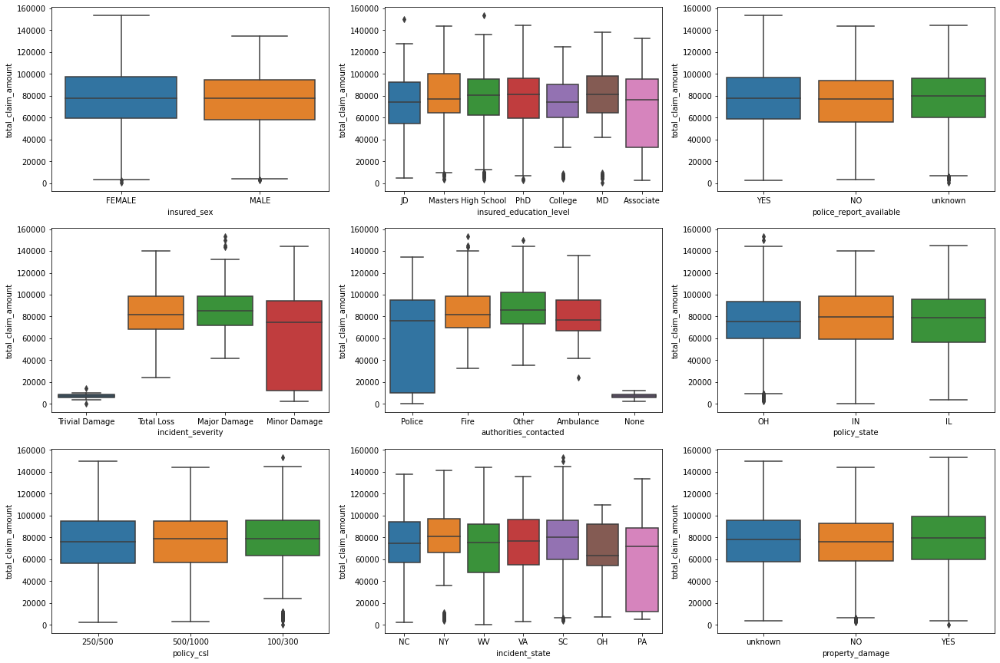

In [2925]:
plt.figure(figsize=(22, 15))
plt.subplot(3,3,1)
sns.boxplot(x = 'insured_sex', y = 'total_claim_amount', data = df)
plt.subplot(3,3,2)
sns.boxplot(x = 'insured_education_level', y = 'total_claim_amount', data = df)
plt.subplot(3,3,3)
sns.boxplot(x = 'police_report_available', y = 'total_claim_amount', data = df)
plt.subplot(3,3,4)
sns.boxplot(x = 'incident_severity', y = 'total_claim_amount', data = df)
plt.subplot(3,3,5)
sns.boxplot(x = 'authorities_contacted', y = 'total_claim_amount', data = df)
plt.subplot(3,3,6)
sns.boxplot(x = 'policy_state', y = 'total_claim_amount', data = df)
plt.subplot(3,3,7)
sns.boxplot(x = 'policy_csl', y = 'total_claim_amount', data = df)
plt.subplot(3,3,8)
sns.boxplot(x = 'incident_state', y = 'total_claim_amount', data = df)
plt.subplot(3,3,9)
sns.boxplot(x = 'property_damage', y = 'total_claim_amount', data = df)
plt.show()

insights:
 - Both male and female have similar average total claims, but females have collected the highest amount of claim
 - The highest amount of claim have been collected with police report 
 - vehicles with trivial damage have generally collected the least claim, while vehicles that had total loss or major damage have a higher mean claim

(array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13]),
 <a list of 14 Text major ticklabel objects>)

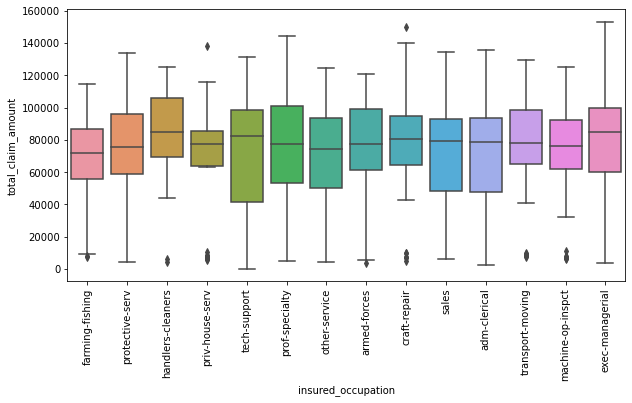

In [2926]:
plt.figure(figsize=(10, 5))
sns.boxplot(x = 'insured_occupation', y = 'total_claim_amount', data = df)
plt.xticks(rotation=90)

(array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
        17, 18, 19]),
 <a list of 20 Text major ticklabel objects>)

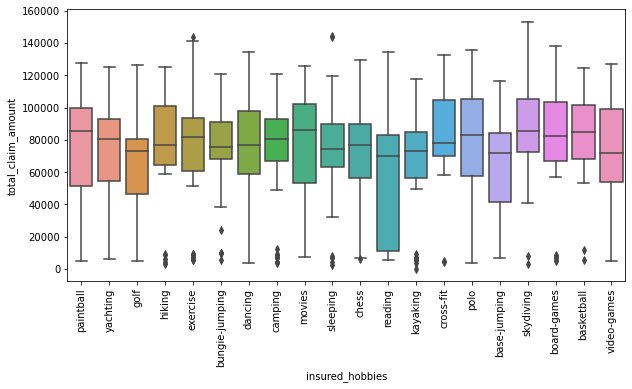

In [2927]:
plt.figure(figsize=(10, 5))
sns.boxplot(x = 'insured_hobbies', y = 'total_claim_amount', data = df)
plt.xticks(rotation=90)

(array([0, 1, 2, 3, 4, 5]), <a list of 6 Text major ticklabel objects>)

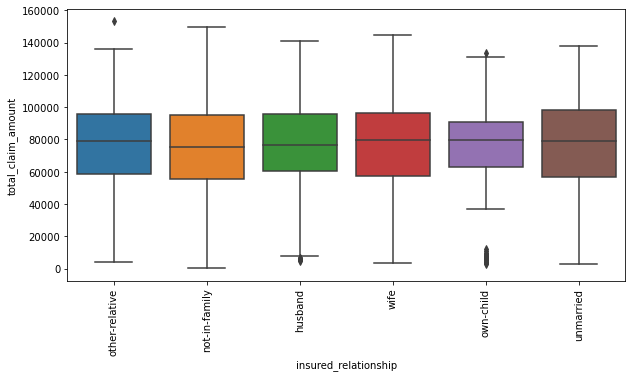

In [2928]:
plt.figure(figsize=(10, 5))
sns.boxplot(x = 'insured_relationship', y = 'total_claim_amount', data = df)
plt.xticks(rotation=90)

(array([0, 1, 2, 3]), <a list of 4 Text major ticklabel objects>)

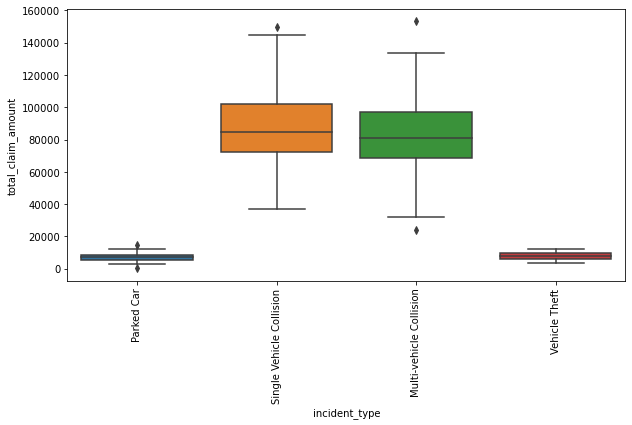

In [2929]:
plt.figure(figsize=(10, 5))
sns.boxplot(x = 'incident_type', y = 'total_claim_amount', data = df)
plt.xticks(rotation=90)

(array([0, 1, 2, 3, 4, 5, 6]), <a list of 7 Text major ticklabel objects>)

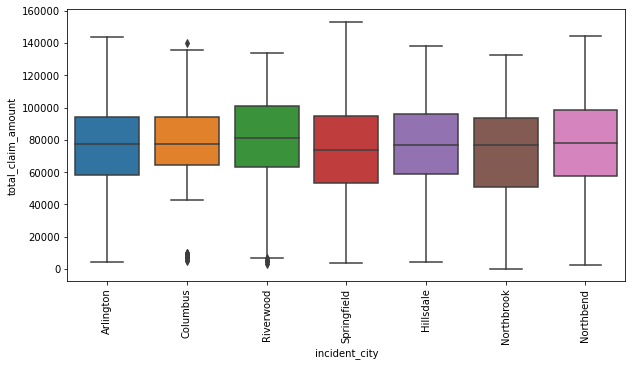

In [2930]:
plt.figure(figsize=(10, 5))
sns.boxplot(x = 'incident_city', y = 'total_claim_amount', data = df)
plt.xticks(rotation=90)

(array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13]),
 <a list of 14 Text major ticklabel objects>)

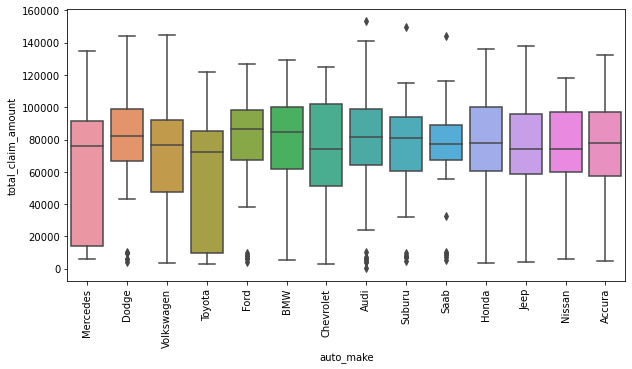

In [2931]:
plt.figure(figsize=(10, 5))
sns.boxplot(x = 'auto_make', y = 'total_claim_amount', data = df)
plt.xticks(rotation=90)

(array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
        17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33,
        34, 35, 36, 37, 38]),
 <a list of 39 Text major ticklabel objects>)

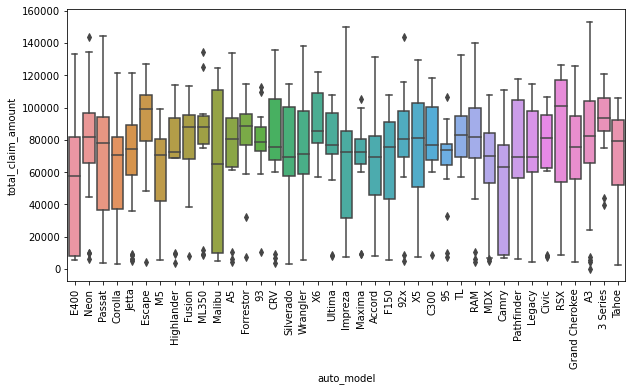

In [2932]:
plt.figure(figsize=(10, 5))
sns.boxplot(x = 'auto_model', y = 'total_claim_amount', data = df)
plt.xticks(rotation=90)

(array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
        17, 18, 19, 20]),
 <a list of 21 Text major ticklabel objects>)

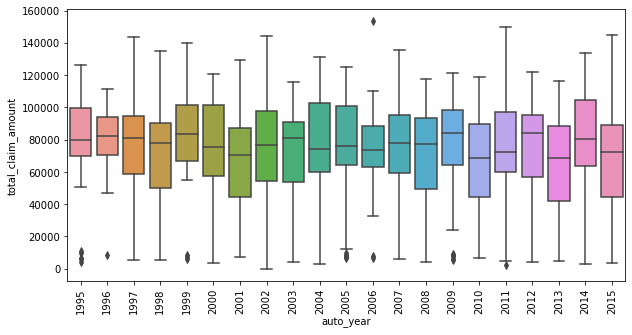

In [2933]:
plt.figure(figsize=(10, 5))
sns.boxplot(x = 'auto_year', y = 'total_claim_amount', data = df)
plt.xticks(rotation=90)

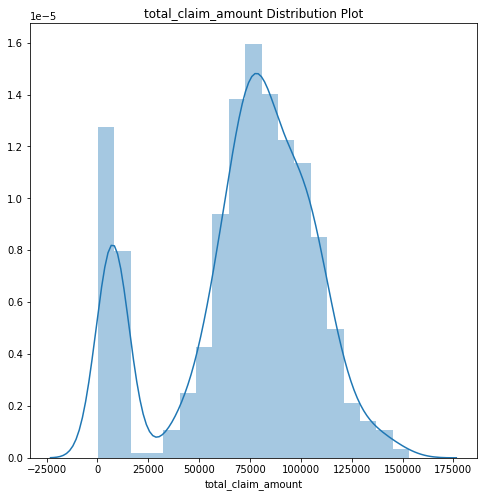

In [2934]:
plt.figure(figsize=(8,8))
plt.title('total_claim_amount Distribution Plot')
sns.distplot(df['total_claim_amount'])

This is not a normal distribution and should be converted to get better results

In [2935]:
df['total_claim_amount']=np.log(df['total_claim_amount'])

Spliting the dataset into dependent and independent variables (y and x)

In [2936]:
x=df.drop('total_claim_amount', axis=1)

In [2937]:
y=df['total_claim_amount']

In [2938]:
y

0       9.574057
1      11.244261
2      11.284267
3      11.709150
4      11.297750
         ...    
695    11.574961
696    11.641612
697    11.270429
698    11.491361
699    10.555813
Name: total_claim_amount, Length: 700, dtype: float64

In [2939]:
x.shape

(700, 31)

In [2940]:
scaler = preprocessing.StandardScaler()
sig_num_col = ['policy_annual_premium']

In [2941]:
x[sig_num_col]=scaler.fit_transform(x[sig_num_col])

In [2942]:
y

0       9.574057
1      11.244261
2      11.284267
3      11.709150
4      11.297750
         ...    
695    11.574961
696    11.641612
697    11.270429
698    11.491361
699    10.555813
Name: total_claim_amount, Length: 700, dtype: float64

In [2943]:
x.head()

,months_as_customer,age,insured_sex,insured_education_level,insured_occupation,insured_hobbies,insured_relationship,capital-gains,capital-loss,policy_state,policy_csl,policy_deductable,incident_location,incident_hour_of_the_day,number_of_vehicles_involved,property_damage,bodily_injuries,policy_annual_premium,umbrella_limit,incident_type,collision_type,incident_severity,authorities_contacted,incident_state,incident_city,witnesses,police_report_available,auto_make,auto_model,auto_year,date_difference_months
0,239,41,FEMALE,JD,farming-fishing,paintball,other-relative,51400,-6300,OH,250/500,1000,6303 1st Drive,22,1,unknown,0,0.274575,7000000,Parked Car,unknown,Trivial Damage,Police,NC,Arlington,2,YES,Mercedes,E400,2013,15
1,108,31,MALE,Masters,protective-serv,yachting,not-in-family,0,0,IN,500/1000,2000,5585 Washington Drive,14,1,NO,0,-0.325733,0,Single Vehicle Collision,Rear Collision,Total Loss,Fire,NY,Columbus,2,NO,Dodge,Neon,2006,110
2,116,30,MALE,JD,handlers-cleaners,golf,not-in-family,0,-35500,IN,500/1000,500,1328 Texas Lane,8,3,NO,0,-1.224712,0,Multi-vehicle Collision,Front Collision,Major Damage,Other,WV,Riverwood,3,unknown,Volkswagen,Passat,2004,158
3,8,21,MALE,High School,handlers-cleaners,hiking,husband,0,0,IN,500/1000,500,6117 4th Ave,21,1,unknown,0,-0.942318,0,Single Vehicle Collision,Front Collision,Major Damage,Other,WV,Columbus,0,unknown,Toyota,Corolla,2012,27
4,161,38,MALE,PhD,priv-house-serv,exercise,not-in-family,60200,0,IL,100/300,2000,2272 Embaracadero Drive,0,3,YES,2,-0.493510,0,Multi-vehicle Collision,Front Collision,Total Loss,Police,WV,Springfield,2,YES,Volkswagen,Jetta,2003,132


In [2944]:
from sklearn.preprocessing import OneHotEncoder
from sklearn.compose import ColumnTransformer

In [2945]:
le = preprocessing.LabelEncoder()
x_encoded = x.apply(le.fit_transform)
x_encoded.head()

,months_as_customer,age,insured_sex,insured_education_level,insured_occupation,insured_hobbies,insured_relationship,capital-gains,capital-loss,policy_state,policy_csl,policy_deductable,incident_location,incident_hour_of_the_day,number_of_vehicles_involved,property_damage,bodily_injuries,policy_annual_premium,umbrella_limit,incident_type,collision_type,incident_severity,authorities_contacted,incident_state,incident_city,witnesses,police_report_available,auto_make,auto_model,auto_year,date_difference_months
0,199,22,0,3,4,13,2,132,285,2,1,1,412,22,0,2,0,412,6,1,3,3,4,0,0,2,1,8,12,18,14
1,84,12,1,5,10,19,1,0,287,1,2,2,366,14,0,0,0,260,0,2,1,2,1,1,1,2,0,4,27,11,100
2,90,11,1,3,5,9,1,0,236,1,2,0,21,8,2,0,0,70,0,0,0,0,3,6,5,3,2,13,28,9,143
3,6,2,1,2,5,10,0,0,287,1,2,0,402,21,0,2,0,124,0,2,0,0,3,6,1,0,2,12,11,17,26
4,130,19,1,6,8,8,1,186,287,0,0,2,99,0,2,1,2,216,0,0,0,2,4,6,6,2,1,13,20,8,120


In [2946]:
x_encoded.shape

(700, 31)

In [2947]:
#latest parameters #rf10
from sklearn.ensemble import RandomForestRegressor
randomforestmodel=RandomForestRegressor(bootstrap=False, max_depth=1, min_samples_leaf=3,
                      min_samples_split=10, n_estimators=20, n_jobs=-1)
randomforestmodel.fit(x_encoded,y)

RandomForestRegressor(bootstrap=False, max_depth=1, min_samples_leaf=3,
                      min_samples_split=10, n_estimators=20, n_jobs=-1)

# IMPORTING THE TEST DATASET FOR PREDICTION

In [2948]:
df_test=pd.read_csv('test.csv')

In [2949]:
df_test.head()

,Customer_ID,months_as_customer,age,insured_sex,insured_education_level,insured_occupation,insured_hobbies,insured_relationship,capital-gains,capital-loss,policy_number,policy_bind_date,policy_state,policy_csl,policy_deductable,incident_location,incident_hour_of_the_day,number_of_vehicles_involved,property_damage,bodily_injuries,policy_annual_premium,umbrella_limit,insured_zip,incident_date,incident_type,collision_type,incident_severity,authorities_contacted,incident_state,incident_city,witnesses,police_report_available,auto_make,auto_model,auto_year,_c39
0,Customer_521,5,26,FEMALE,PhD,farming-fishing,skydiving,not-in-family,31500,0,924318,2014-07-27,IL,250/500,2000,3706 Texas Hwy,22,1,YES,1,1137.02,0,468872,2015-01-25,Single Vehicle Collision,Rear Collision,Total Loss,Ambulance,WV,Springfield,3,?,Audi,A5,2003,NaN
1,Customer_737,160,33,FEMALE,High School,exec-managerial,exercise,husband,61600,0,180286,2009-02-08,IL,500/1000,1000,1989 Solo Lane,17,3,?,2,1422.78,0,616583,2015-01-20,Multi-vehicle Collision,Front Collision,Total Loss,Ambulance,NC,Riverwood,3,YES,Nissan,Pathfinder,2006,NaN
2,Customer_740,385,51,FEMALE,MD,craft-repair,reading,husband,0,-61000,178081,1990-07-20,IN,250/500,1000,1422 Flute Ave,14,3,?,1,976.37,0,602842,2015-02-18,Multi-vehicle Collision,Rear Collision,Minor Damage,Other,WV,Riverwood,3,?,Suburu,Legacy,2007,NaN
3,Customer_660,446,57,MALE,College,adm-clerical,sleeping,unmarried,42700,-64900,991480,1992-12-09,IN,100/300,2000,9734 2nd Ridge,10,3,NO,0,1373.21,0,478486,2015-02-14,Multi-vehicle Collision,Front Collision,Total Loss,Police,SC,Northbrook,0,NO,Jeep,Wrangler,2012,NaN
4,Customer_411,84,29,FEMALE,High School,machine-op-inspct,video-games,not-in-family,0,-29900,630998,2003-04-09,OH,250/500,1000,3693 Pine Ave,6,1,YES,2,1117.17,0,473645,2015-02-12,Parked Car,?,Trivial Damage,Police,SC,Arlington,0,YES,BMW,3 Series,2005,NaN


In [2950]:
df_test.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 300 entries, 0 to 299
Data columns (total 36 columns):
 #   Column                       Non-Null Count  Dtype  
---  ------                       --------------  -----  
 0   Customer_ID                  300 non-null    object 
 1   months_as_customer           300 non-null    int64  
 2   age                          300 non-null    int64  
 3   insured_sex                  300 non-null    object 
 4   insured_education_level      300 non-null    object 
 5   insured_occupation           300 non-null    object 
 6   insured_hobbies              300 non-null    object 
 7   insured_relationship         300 non-null    object 
 8   capital-gains                300 non-null    int64  
 9   capital-loss                 300 non-null    int64  
 10  policy_number                300 non-null    int64  
 11  policy_bind_date             300 non-null    object 
 12  policy_state                 300 non-null    object 
 13  policy_csl          

In [2951]:
df_test['policy_bind_date'] = pd.to_datetime(df_test['policy_bind_date'],format="%Y/%m/%d")

In [2952]:
df_test['incident_date'] =  pd.to_datetime(df_test['incident_date'],format="%Y/%m/%d")

In [2953]:
df_test['date_difference_months'] = ((df_test.incident_date - df_test.policy_bind_date)/np.timedelta64(1, 'M'))

In [2954]:
df_test['date_difference_months'] = df_test['date_difference_months'].astype(int)

In [2955]:
df_test.head()

,Customer_ID,months_as_customer,age,insured_sex,insured_education_level,insured_occupation,insured_hobbies,insured_relationship,capital-gains,capital-loss,policy_number,policy_bind_date,policy_state,policy_csl,policy_deductable,incident_location,incident_hour_of_the_day,number_of_vehicles_involved,property_damage,bodily_injuries,policy_annual_premium,umbrella_limit,insured_zip,incident_date,incident_type,collision_type,incident_severity,authorities_contacted,incident_state,incident_city,witnesses,police_report_available,auto_make,auto_model,auto_year,_c39,date_difference_months
0,Customer_521,5,26,FEMALE,PhD,farming-fishing,skydiving,not-in-family,31500,0,924318,2014-07-27,IL,250/500,2000,3706 Texas Hwy,22,1,YES,1,1137.02,0,468872,2015-01-25,Single Vehicle Collision,Rear Collision,Total Loss,Ambulance,WV,Springfield,3,?,Audi,A5,2003,NaN,5
1,Customer_737,160,33,FEMALE,High School,exec-managerial,exercise,husband,61600,0,180286,2009-02-08,IL,500/1000,1000,1989 Solo Lane,17,3,?,2,1422.78,0,616583,2015-01-20,Multi-vehicle Collision,Front Collision,Total Loss,Ambulance,NC,Riverwood,3,YES,Nissan,Pathfinder,2006,NaN,71
2,Customer_740,385,51,FEMALE,MD,craft-repair,reading,husband,0,-61000,178081,1990-07-20,IN,250/500,1000,1422 Flute Ave,14,3,?,1,976.37,0,602842,2015-02-18,Multi-vehicle Collision,Rear Collision,Minor Damage,Other,WV,Riverwood,3,?,Suburu,Legacy,2007,NaN,295
3,Customer_660,446,57,MALE,College,adm-clerical,sleeping,unmarried,42700,-64900,991480,1992-12-09,IN,100/300,2000,9734 2nd Ridge,10,3,NO,0,1373.21,0,478486,2015-02-14,Multi-vehicle Collision,Front Collision,Total Loss,Police,SC,Northbrook,0,NO,Jeep,Wrangler,2012,NaN,266
4,Customer_411,84,29,FEMALE,High School,machine-op-inspct,video-games,not-in-family,0,-29900,630998,2003-04-09,OH,250/500,1000,3693 Pine Ave,6,1,YES,2,1117.17,0,473645,2015-02-12,Parked Car,?,Trivial Damage,Police,SC,Arlington,0,YES,BMW,3 Series,2005,NaN,142


In [2956]:
df_test_main=df_test.drop(['Customer_ID','policy_bind_date','insured_zip','incident_date','_c39','policy_number'], axis =1)

In [2957]:
df_test.head()

,Customer_ID,months_as_customer,age,insured_sex,insured_education_level,insured_occupation,insured_hobbies,insured_relationship,capital-gains,capital-loss,policy_number,policy_bind_date,policy_state,policy_csl,policy_deductable,incident_location,incident_hour_of_the_day,number_of_vehicles_involved,property_damage,bodily_injuries,policy_annual_premium,umbrella_limit,insured_zip,incident_date,incident_type,collision_type,incident_severity,authorities_contacted,incident_state,incident_city,witnesses,police_report_available,auto_make,auto_model,auto_year,_c39,date_difference_months
0,Customer_521,5,26,FEMALE,PhD,farming-fishing,skydiving,not-in-family,31500,0,924318,2014-07-27,IL,250/500,2000,3706 Texas Hwy,22,1,YES,1,1137.02,0,468872,2015-01-25,Single Vehicle Collision,Rear Collision,Total Loss,Ambulance,WV,Springfield,3,?,Audi,A5,2003,NaN,5
1,Customer_737,160,33,FEMALE,High School,exec-managerial,exercise,husband,61600,0,180286,2009-02-08,IL,500/1000,1000,1989 Solo Lane,17,3,?,2,1422.78,0,616583,2015-01-20,Multi-vehicle Collision,Front Collision,Total Loss,Ambulance,NC,Riverwood,3,YES,Nissan,Pathfinder,2006,NaN,71
2,Customer_740,385,51,FEMALE,MD,craft-repair,reading,husband,0,-61000,178081,1990-07-20,IN,250/500,1000,1422 Flute Ave,14,3,?,1,976.37,0,602842,2015-02-18,Multi-vehicle Collision,Rear Collision,Minor Damage,Other,WV,Riverwood,3,?,Suburu,Legacy,2007,NaN,295
3,Customer_660,446,57,MALE,College,adm-clerical,sleeping,unmarried,42700,-64900,991480,1992-12-09,IN,100/300,2000,9734 2nd Ridge,10,3,NO,0,1373.21,0,478486,2015-02-14,Multi-vehicle Collision,Front Collision,Total Loss,Police,SC,Northbrook,0,NO,Jeep,Wrangler,2012,NaN,266
4,Customer_411,84,29,FEMALE,High School,machine-op-inspct,video-games,not-in-family,0,-29900,630998,2003-04-09,OH,250/500,1000,3693 Pine Ave,6,1,YES,2,1117.17,0,473645,2015-02-12,Parked Car,?,Trivial Damage,Police,SC,Arlington,0,YES,BMW,3 Series,2005,NaN,142


In [2958]:
df_test_main.head()

,months_as_customer,age,insured_sex,insured_education_level,insured_occupation,insured_hobbies,insured_relationship,capital-gains,capital-loss,policy_state,policy_csl,policy_deductable,incident_location,incident_hour_of_the_day,number_of_vehicles_involved,property_damage,bodily_injuries,policy_annual_premium,umbrella_limit,incident_type,collision_type,incident_severity,authorities_contacted,incident_state,incident_city,witnesses,police_report_available,auto_make,auto_model,auto_year,date_difference_months
0,5,26,FEMALE,PhD,farming-fishing,skydiving,not-in-family,31500,0,IL,250/500,2000,3706 Texas Hwy,22,1,YES,1,1137.02,0,Single Vehicle Collision,Rear Collision,Total Loss,Ambulance,WV,Springfield,3,?,Audi,A5,2003,5
1,160,33,FEMALE,High School,exec-managerial,exercise,husband,61600,0,IL,500/1000,1000,1989 Solo Lane,17,3,?,2,1422.78,0,Multi-vehicle Collision,Front Collision,Total Loss,Ambulance,NC,Riverwood,3,YES,Nissan,Pathfinder,2006,71
2,385,51,FEMALE,MD,craft-repair,reading,husband,0,-61000,IN,250/500,1000,1422 Flute Ave,14,3,?,1,976.37,0,Multi-vehicle Collision,Rear Collision,Minor Damage,Other,WV,Riverwood,3,?,Suburu,Legacy,2007,295
3,446,57,MALE,College,adm-clerical,sleeping,unmarried,42700,-64900,IN,100/300,2000,9734 2nd Ridge,10,3,NO,0,1373.21,0,Multi-vehicle Collision,Front Collision,Total Loss,Police,SC,Northbrook,0,NO,Jeep,Wrangler,2012,266
4,84,29,FEMALE,High School,machine-op-inspct,video-games,not-in-family,0,-29900,OH,250/500,1000,3693 Pine Ave,6,1,YES,2,1117.17,0,Parked Car,?,Trivial Damage,Police,SC,Arlington,0,YES,BMW,3 Series,2005,142


In [2959]:
df_test_main = df_test_main.astype({'auto_year':'object','incident_hour_of_the_day':'object'})

In [2960]:
df_test_main.profile_report()

Summarize dataset:   0%|          | 0/44 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [2961]:
df_test_main['property_damage'].unique()

array(['YES', '?', 'NO'], dtype=object)

In [2962]:
df_test_main['property_damage'].replace("?","unknown", inplace=True)

In [2963]:
df_test_main['property_damage'].unique()

array(['YES', 'unknown', 'NO'], dtype=object)

In [2964]:
df_test_main['collision_type'].replace("?","unknown",inplace=True)

In [2965]:
print(df_test_main['collision_type'].unique())

['Rear Collision' 'Front Collision' 'unknown' 'Side Collision']


In [2966]:
df_test_main['police_report_available'].replace("?","unknown",inplace=True)

In [2967]:
df_test_main['police_report_available'].unique()

array(['unknown', 'YES', 'NO'], dtype=object)

In [2968]:
df_test_main.head()

,months_as_customer,age,insured_sex,insured_education_level,insured_occupation,insured_hobbies,insured_relationship,capital-gains,capital-loss,policy_state,policy_csl,policy_deductable,incident_location,incident_hour_of_the_day,number_of_vehicles_involved,property_damage,bodily_injuries,policy_annual_premium,umbrella_limit,incident_type,collision_type,incident_severity,authorities_contacted,incident_state,incident_city,witnesses,police_report_available,auto_make,auto_model,auto_year,date_difference_months
0,5,26,FEMALE,PhD,farming-fishing,skydiving,not-in-family,31500,0,IL,250/500,2000,3706 Texas Hwy,22,1,YES,1,1137.02,0,Single Vehicle Collision,Rear Collision,Total Loss,Ambulance,WV,Springfield,3,unknown,Audi,A5,2003,5
1,160,33,FEMALE,High School,exec-managerial,exercise,husband,61600,0,IL,500/1000,1000,1989 Solo Lane,17,3,unknown,2,1422.78,0,Multi-vehicle Collision,Front Collision,Total Loss,Ambulance,NC,Riverwood,3,YES,Nissan,Pathfinder,2006,71
2,385,51,FEMALE,MD,craft-repair,reading,husband,0,-61000,IN,250/500,1000,1422 Flute Ave,14,3,unknown,1,976.37,0,Multi-vehicle Collision,Rear Collision,Minor Damage,Other,WV,Riverwood,3,unknown,Suburu,Legacy,2007,295
3,446,57,MALE,College,adm-clerical,sleeping,unmarried,42700,-64900,IN,100/300,2000,9734 2nd Ridge,10,3,NO,0,1373.21,0,Multi-vehicle Collision,Front Collision,Total Loss,Police,SC,Northbrook,0,NO,Jeep,Wrangler,2012,266
4,84,29,FEMALE,High School,machine-op-inspct,video-games,not-in-family,0,-29900,OH,250/500,1000,3693 Pine Ave,6,1,YES,2,1117.17,0,Parked Car,unknown,Trivial Damage,Police,SC,Arlington,0,YES,BMW,3 Series,2005,142


In [2969]:
scaler = preprocessing.StandardScaler()
sig_num_col1 = ['policy_annual_premium']

In [2970]:
df_test_main[sig_num_col]=scaler.fit_transform(df_test_main[sig_num_col])

In [2971]:
le1 = preprocessing.LabelEncoder()
df_test_encoded = df_test_main.apply(le1.fit_transform)
df_test_encoded.head()

,months_as_customer,age,insured_sex,insured_education_level,insured_occupation,insured_hobbies,insured_relationship,capital-gains,capital-loss,policy_state,policy_csl,policy_deductable,incident_location,incident_hour_of_the_day,number_of_vehicles_involved,property_damage,bodily_injuries,policy_annual_premium,umbrella_limit,incident_type,collision_type,incident_severity,authorities_contacted,incident_state,incident_city,witnesses,police_report_available,auto_make,auto_model,auto_year,date_difference_months
0,3,4,0,6,4,16,1,16,138,0,1,2,83,22,0,1,1,94,1,2,1,2,0,6,6,3,2,1,5,8,4
1,93,11,0,2,3,8,0,103,138,0,2,1,30,17,2,2,2,235,1,0,0,2,0,0,5,3,1,9,29,11,49
2,191,29,0,4,2,15,0,0,40,1,1,1,11,14,2,2,1,36,1,0,1,1,3,6,5,3,2,11,21,12,192
3,205,35,1,1,0,17,4,36,33,1,0,2,292,10,2,0,0,213,1,0,0,2,4,4,4,0,0,7,36,17,170
4,39,7,0,2,6,18,1,0,124,2,1,1,81,6,0,1,2,87,1,1,3,3,4,4,0,0,1,2,0,10,97


In [2972]:
df_test_encoded.shape

(300, 31)

In [2973]:
df_test_encoded.head()

,months_as_customer,age,insured_sex,insured_education_level,insured_occupation,insured_hobbies,insured_relationship,capital-gains,capital-loss,policy_state,policy_csl,policy_deductable,incident_location,incident_hour_of_the_day,number_of_vehicles_involved,property_damage,bodily_injuries,policy_annual_premium,umbrella_limit,incident_type,collision_type,incident_severity,authorities_contacted,incident_state,incident_city,witnesses,police_report_available,auto_make,auto_model,auto_year,date_difference_months
0,3,4,0,6,4,16,1,16,138,0,1,2,83,22,0,1,1,94,1,2,1,2,0,6,6,3,2,1,5,8,4
1,93,11,0,2,3,8,0,103,138,0,2,1,30,17,2,2,2,235,1,0,0,2,0,0,5,3,1,9,29,11,49
2,191,29,0,4,2,15,0,0,40,1,1,1,11,14,2,2,1,36,1,0,1,1,3,6,5,3,2,11,21,12,192
3,205,35,1,1,0,17,4,36,33,1,0,2,292,10,2,0,0,213,1,0,0,2,4,4,4,0,0,7,36,17,170
4,39,7,0,2,6,18,1,0,124,2,1,1,81,6,0,1,2,87,1,1,3,3,4,4,0,0,1,2,0,10,97


In [2974]:
y_pred=randomforestmodel.predict(df_test_encoded)

The predicted values have to be converted back from log scale

In [2975]:
Predicted_total_claim_amount = np.exp(y_pred)

In [2976]:
df_test['total_claim_amount'] = Predicted_total_claim_amount

In [2977]:
df_test.head()

,Customer_ID,months_as_customer,age,insured_sex,insured_education_level,insured_occupation,insured_hobbies,insured_relationship,capital-gains,capital-loss,policy_number,policy_bind_date,policy_state,policy_csl,policy_deductable,incident_location,incident_hour_of_the_day,number_of_vehicles_involved,property_damage,bodily_injuries,policy_annual_premium,umbrella_limit,insured_zip,incident_date,incident_type,collision_type,incident_severity,authorities_contacted,incident_state,incident_city,witnesses,police_report_available,auto_make,auto_model,auto_year,_c39,date_difference_months,total_claim_amount
0,Customer_521,5,26,FEMALE,PhD,farming-fishing,skydiving,not-in-family,31500,0,924318,2014-07-27,IL,250/500,2000,3706 Texas Hwy,22,1,YES,1,1137.02,0,468872,2015-01-25,Single Vehicle Collision,Rear Collision,Total Loss,Ambulance,WV,Springfield,3,?,Audi,A5,2003,NaN,5,82015.372787
1,Customer_737,160,33,FEMALE,High School,exec-managerial,exercise,husband,61600,0,180286,2009-02-08,IL,500/1000,1000,1989 Solo Lane,17,3,?,2,1422.78,0,616583,2015-01-20,Multi-vehicle Collision,Front Collision,Total Loss,Ambulance,NC,Riverwood,3,YES,Nissan,Pathfinder,2006,NaN,71,82015.372787
2,Customer_740,385,51,FEMALE,MD,craft-repair,reading,husband,0,-61000,178081,1990-07-20,IN,250/500,1000,1422 Flute Ave,14,3,?,1,976.37,0,602842,2015-02-18,Multi-vehicle Collision,Rear Collision,Minor Damage,Other,WV,Riverwood,3,?,Suburu,Legacy,2007,NaN,295,82015.372787
3,Customer_660,446,57,MALE,College,adm-clerical,sleeping,unmarried,42700,-64900,991480,1992-12-09,IN,100/300,2000,9734 2nd Ridge,10,3,NO,0,1373.21,0,478486,2015-02-14,Multi-vehicle Collision,Front Collision,Total Loss,Police,SC,Northbrook,0,NO,Jeep,Wrangler,2012,NaN,266,82015.372787
4,Customer_411,84,29,FEMALE,High School,machine-op-inspct,video-games,not-in-family,0,-29900,630998,2003-04-09,OH,250/500,1000,3693 Pine Ave,6,1,YES,2,1117.17,0,473645,2015-02-12,Parked Car,?,Trivial Damage,Police,SC,Arlington,0,YES,BMW,3 Series,2005,NaN,142,6906.836908


In [2978]:
prediction= df_test[['Customer_ID','total_claim_amount']]

In [2979]:
prediction.columns

Index(['Customer_ID', 'total_claim_amount'], dtype='object')

In [2980]:
prediction.to_csv('Folayan Submission.csv', index=False)

USING RANDOMIZED SEARCH CV TO DETERMINE BEST PARAMETERS FOR RANDOM FOREST

In [2981]:
from sklearn.model_selection import RandomizedSearchCV
from pprint import pprint

# Number of trees in random forest
n_estimators = [int(x) for x in np.linspace(start = 20, stop = 200, num = 5)]
# Number of features to consider at every split
max_features = ['auto', 'sqrt']
# Maximum number of levels in tree
max_depth = [int(x) for x in np.linspace(1, 45, num = 3)]
# Minimum number of samples required to split a node
min_samples_split = [5, 10]

# Create the random grid
random_grid = {'n_estimators': n_estimators,
               'max_features': max_features,
               'max_depth': max_depth,
               'min_samples_split': min_samples_split}
pprint(random_grid)

{'max_depth': [1, 23, 45],
 'max_features': ['auto', 'sqrt'],
 'min_samples_split': [5, 10],
 'n_estimators': [20, 65, 110, 155, 200]}


In [2982]:
# Use the random grid to search for best hyperparameters

# Random search of parameters, using 3 fold cross validation, 
# search across 100 different combinations, and use all available cores
rf_random = RandomizedSearchCV(estimator = randomforestmodel, param_distributions = random_grid, n_iter = 10, cv = 10, verbose=2, random_state=42, n_jobs = -1, scoring='neg_mean_squared_error')
# Fit the random search model
rf_random.fit(x_encoded, y)

Fitting 10 folds for each of 10 candidates, totalling 100 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done  33 tasks      | elapsed:    3.6s
[Parallel(n_jobs=-1)]: Done 100 out of 100 | elapsed:   26.0s finished


RandomizedSearchCV(cv=10,
                   estimator=RandomForestRegressor(bootstrap=False, max_depth=1,
                                                   min_samples_leaf=3,
                                                   min_samples_split=10,
                                                   n_estimators=20, n_jobs=-1),
                   n_jobs=-1,
                   param_distributions={'max_depth': [1, 23, 45],
                                        'max_features': ['auto', 'sqrt'],
                                        'min_samples_split': [5, 10],
                                        'n_estimators': [20, 65, 110, 155,
                                                         200]},
                   random_state=42, scoring='neg_mean_squared_error',
                   verbose=2)

In [2983]:
#now let's how the RMSE changes for each parameter configuration
cvres2 = rf_random.cv_results_
for mean_score, params in zip(cvres2["mean_test_score"], cvres2["params"]):
    print(np.sqrt(-mean_score), params)

0.31688365990393214 {'n_estimators': 20, 'min_samples_split': 5, 'max_features': 'auto', 'max_depth': 1}
0.3168836599039322 {'n_estimators': 20, 'min_samples_split': 10, 'max_features': 'auto', 'max_depth': 1}
0.33312742540706597 {'n_estimators': 65, 'min_samples_split': 10, 'max_features': 'sqrt', 'max_depth': 23}
0.40619206300818816 {'n_estimators': 20, 'min_samples_split': 10, 'max_features': 'auto', 'max_depth': 45}
0.7235529135461051 {'n_estimators': 155, 'min_samples_split': 5, 'max_features': 'sqrt', 'max_depth': 1}
0.33256843247035944 {'n_estimators': 200, 'min_samples_split': 5, 'max_features': 'sqrt', 'max_depth': 45}
0.33440740136427055 {'n_estimators': 155, 'min_samples_split': 5, 'max_features': 'sqrt', 'max_depth': 23}
0.4060948969909825 {'n_estimators': 155, 'min_samples_split': 10, 'max_features': 'auto', 'max_depth': 45}
0.7413391827190317 {'n_estimators': 110, 'min_samples_split': 5, 'max_features': 'sqrt', 'max_depth': 1}
0.33919038591803874 {'n_estimators': 110, 'mi

In [2984]:
rf_random.best_estimator_

RandomForestRegressor(bootstrap=False, max_depth=1, min_samples_leaf=3,
                      min_samples_split=5, n_estimators=20, n_jobs=-1)

In [2985]:
rf_random.best_params_

{'n_estimators': 20,
 'min_samples_split': 5,
 'max_features': 'auto',
 'max_depth': 1}

In [2986]:
rf_random.best_estimator_

RandomForestRegressor(bootstrap=False, max_depth=1, min_samples_leaf=3,
                      min_samples_split=5, n_estimators=20, n_jobs=-1)

In [2715]:
# extract the numerical values of feature importance from the grid search
importances = rf_random.best_estimator_.feature_importances_

#create a feature list from the original dataset (list of columns)
# What are this numbers? Let's get back to the columns of the original dataset
feature_list = list(x.columns)

#create a list of tuples
feature_importance= sorted(zip(importances, feature_list), reverse=True)

#create two lists from the previous list of tuples
df = pd.DataFrame(feature_importance, columns=['importance', 'feature'])
importance= list(df['importance'])
feature= list(df['feature'])

#see df
print(df)

    importance                      feature
0          1.0               collision_type
1          0.0                    witnesses
2          0.0               umbrella_limit
3          0.0              property_damage
4          0.0                 policy_state
5          0.0            policy_deductable
6          0.0                   policy_csl
7          0.0        policy_annual_premium
8          0.0      police_report_available
9          0.0  number_of_vehicles_involved
10         0.0           months_as_customer
11         0.0                  insured_sex
12         0.0      insured_education_level
13         0.0                incident_type
14         0.0               incident_state
15         0.0            incident_severity
16         0.0            incident_location
17         0.0     incident_hour_of_the_day
18         0.0                incident_city
19         0.0       date_difference_months
20         0.0                 capital-loss
21         0.0                ca